In [8]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
import torchvision
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader

In [9]:
# use the Metal backend if available (for Apple computers)
if torch.backends.mps.is_available() and torch.backends.mps.is_built():
    device = torch.device('mps')
# use CUDA if available (for NVIDIA cards)
elif torch.cuda.is_available():
    device = torch.device('cuda')
# otherwise, use the CPU
else:
    device = torch.device('cpu')

print(f'Using device: {device}')

Using device: mps


In [10]:
SIZE = 256

data_train = torchvision.datasets.Imagenette("data", split='train', size="160px")
data_val = torchvision.datasets.Imagenette("data", split='val', size="160px")
data_train = torch.utils.data.Subset(data_train, torch.arange(160))
data_val = torch.utils.data.Subset(data_val, torch.arange(160))

class ColorizationDataset(Dataset):
    def __init__(self, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
    
    def __getitem__(self, idx):
        img = data_train[idx][0].convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(data_train)

def make_dataloaders(batch_size=16, n_workers=0, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [11]:
train_dl = make_dataloaders(split='train')
val_dl = make_dataloaders(split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
10 10


In [12]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False, innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4, stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4, stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

In [13]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
            for i in range(n_down)] # the 'if' statement is taking care of not using stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers, it's always helpful to make a separate method for that purpose
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [14]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, SIZE, SIZE) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

$$\min_G\max_D \mathcal{L}_{\text{GAN}}(G, D) + \lambda\mathcal{L}_{L^1}(G)$$

where $\mathcal{L}_{\text{GAN}}(G, D)$ is the adversarial loss, and $\mathcal{L}_{L^1}(G)$ is the $L^1$ loss:
$$\mathcal{L}_{L^1}(G) = \mathbb{E}_{x, y, z}[\|y - G(x, z)\|_1]$$

In [15]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [16]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [17]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = torch.optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = torch.optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [18]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

model initialized with norm initialization
model initialized with norm initialization


  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 1/20
Iteration 10/10
loss_D_fake: 0.90229
loss_D_real: 0.92134
loss_D: 0.91182
loss_G_GAN: 0.98541
loss_G_L1: 13.60753
loss_G: 14.59294


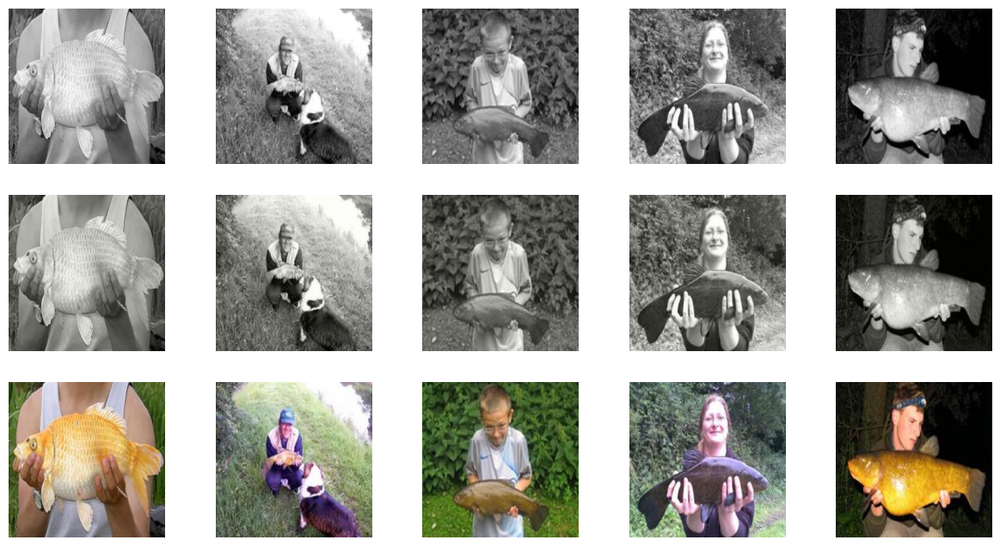

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 2/20
Iteration 10/10
loss_D_fake: 0.68533
loss_D_real: 0.68296
loss_D: 0.68414
loss_G_GAN: 0.82951
loss_G_L1: 9.36208
loss_G: 10.19159


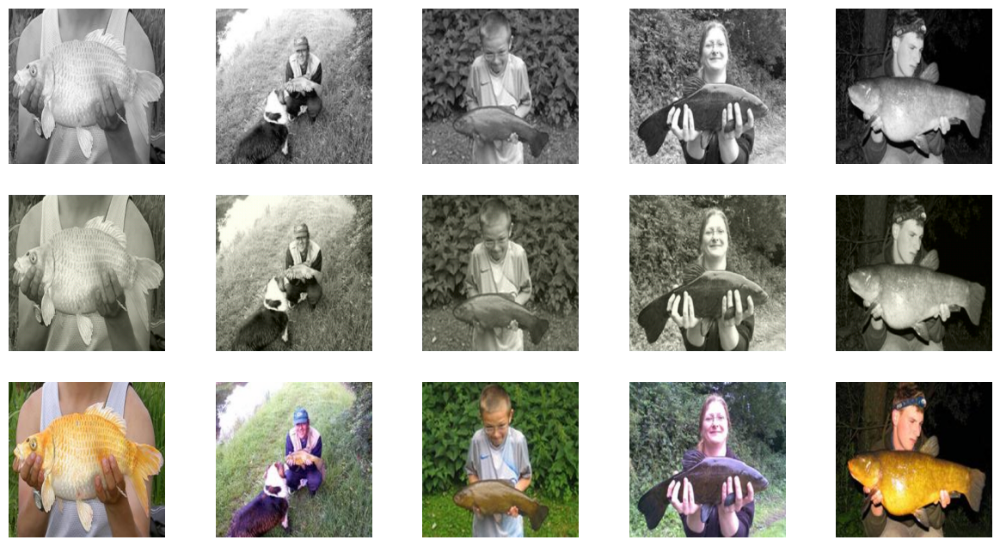

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 3/20
Iteration 10/10
loss_D_fake: 0.63968
loss_D_real: 0.64384
loss_D: 0.64176
loss_G_GAN: 0.90619
loss_G_L1: 8.84110
loss_G: 9.74729


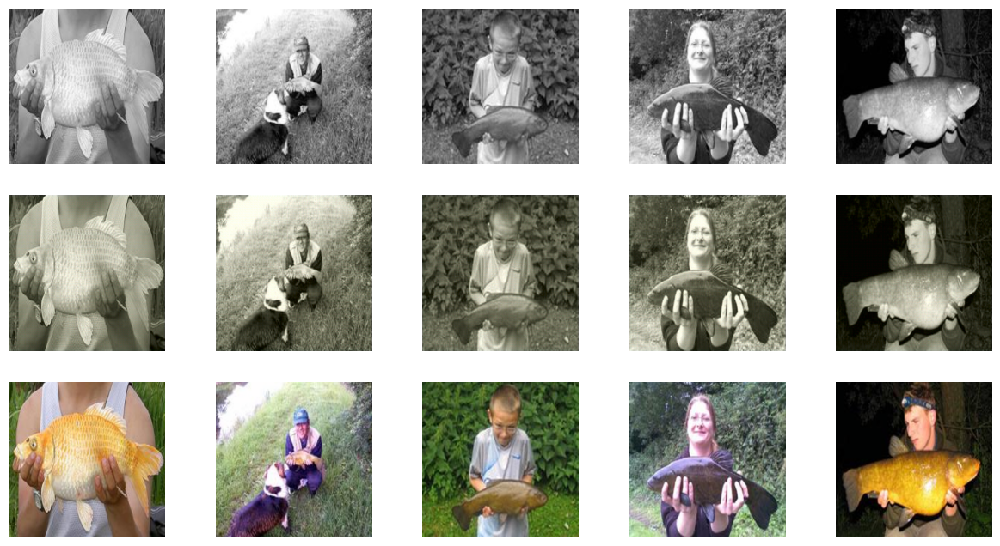

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 4/20
Iteration 10/10
loss_D_fake: 0.60692
loss_D_real: 0.58628
loss_D: 0.59660
loss_G_GAN: 1.00826
loss_G_L1: 8.66842
loss_G: 9.67668


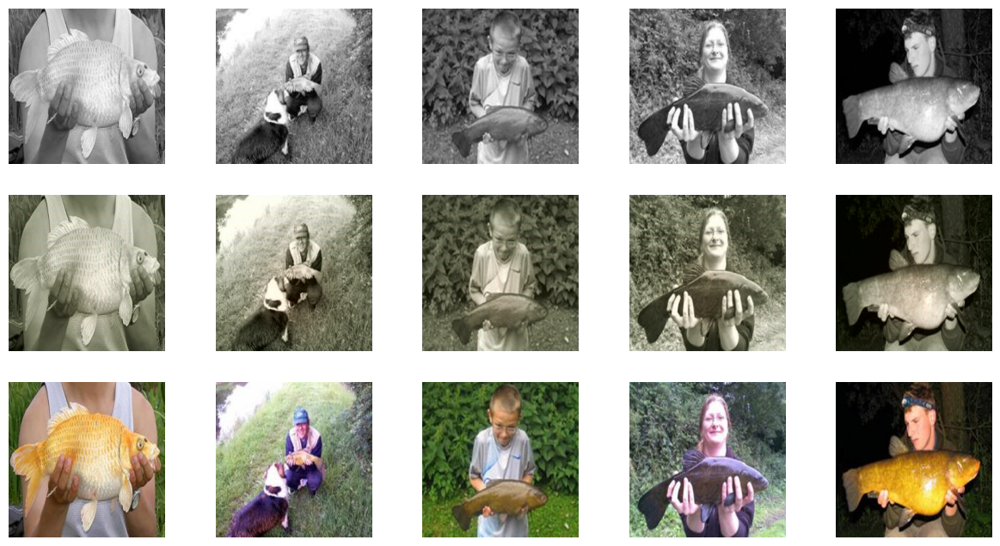

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 5/20
Iteration 10/10
loss_D_fake: 0.51861
loss_D_real: 0.51434
loss_D: 0.51648
loss_G_GAN: 1.13727
loss_G_L1: 8.50827
loss_G: 9.64553


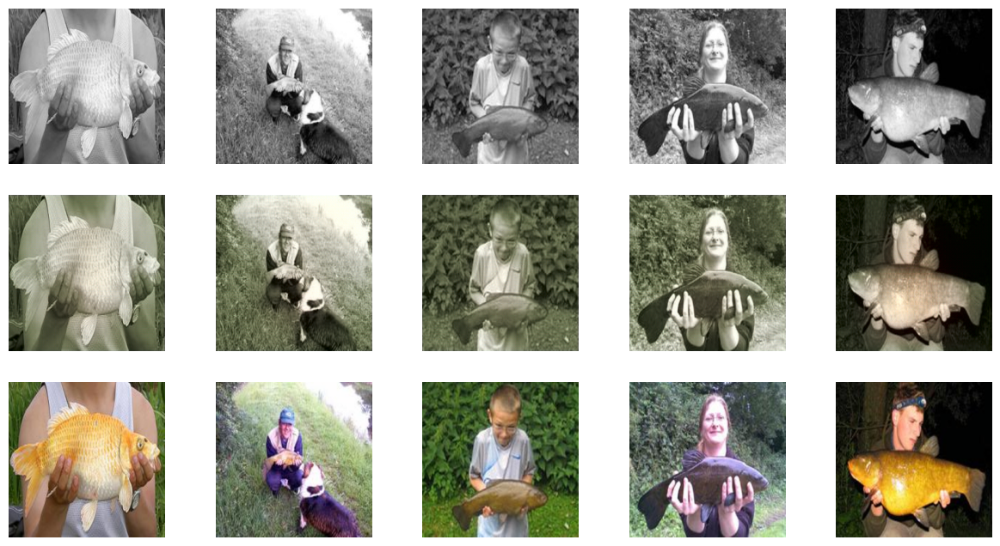

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 6/20
Iteration 10/10
loss_D_fake: 0.49804
loss_D_real: 0.48536
loss_D: 0.49170
loss_G_GAN: 1.18211
loss_G_L1: 8.47575
loss_G: 9.65786


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 39 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


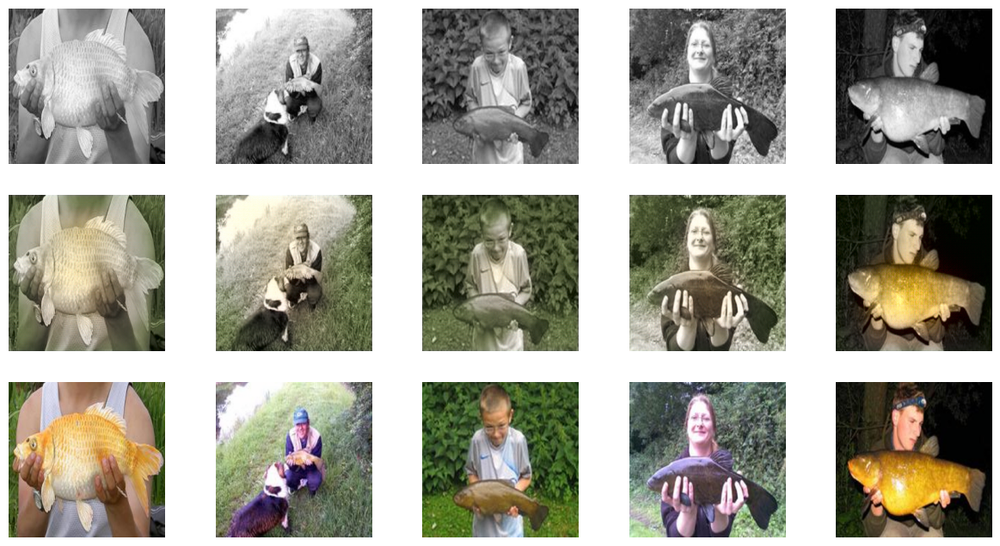

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 7/20
Iteration 10/10
loss_D_fake: 0.49494
loss_D_real: 0.51095
loss_D: 0.50295
loss_G_GAN: 1.26770
loss_G_L1: 8.50222
loss_G: 9.76992


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 109 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


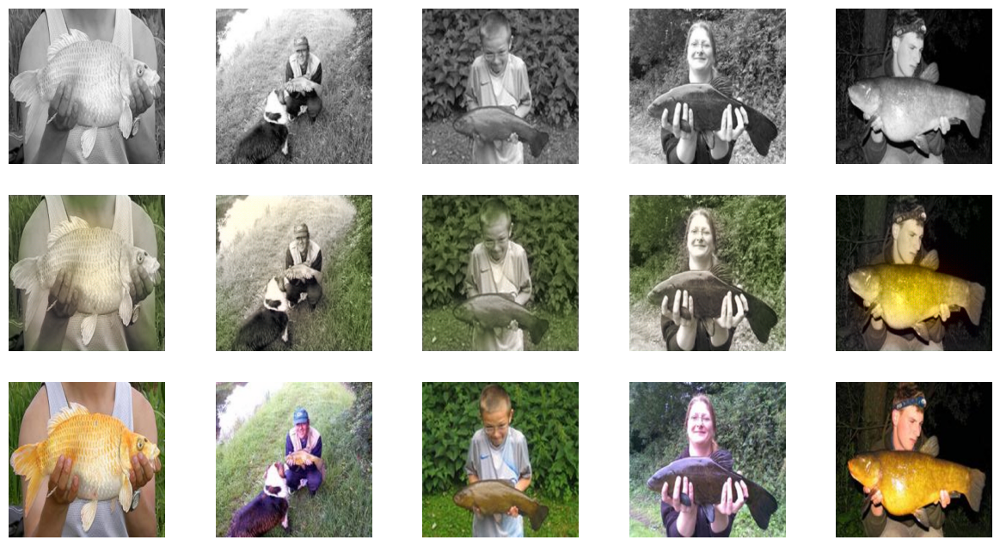

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 8/20
Iteration 10/10
loss_D_fake: 0.45491
loss_D_real: 0.48479
loss_D: 0.46985
loss_G_GAN: 1.36004
loss_G_L1: 8.33622
loss_G: 9.69627


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 3 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


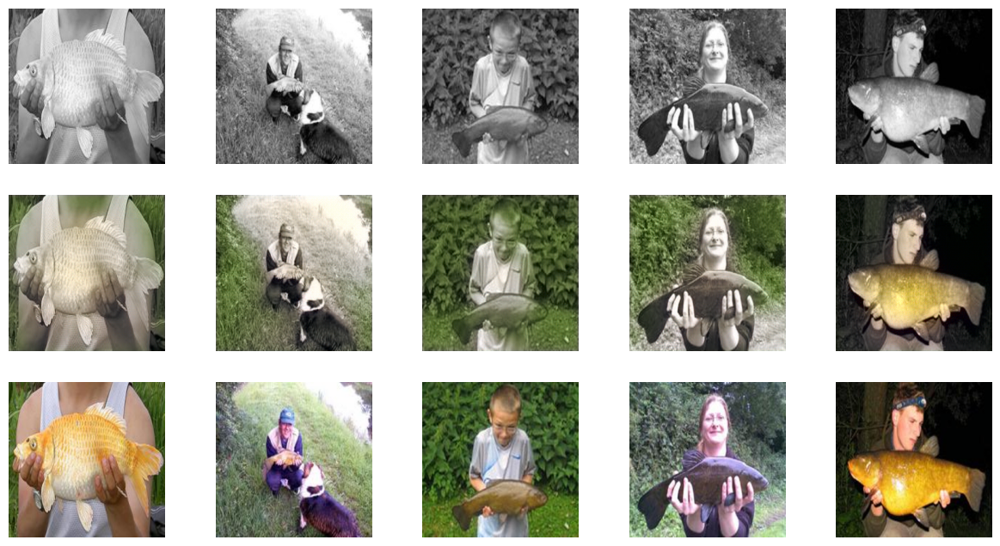

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 9/20
Iteration 10/10
loss_D_fake: 0.35910
loss_D_real: 0.36634
loss_D: 0.36272
loss_G_GAN: 1.52014
loss_G_L1: 8.25222
loss_G: 9.77235


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 7 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


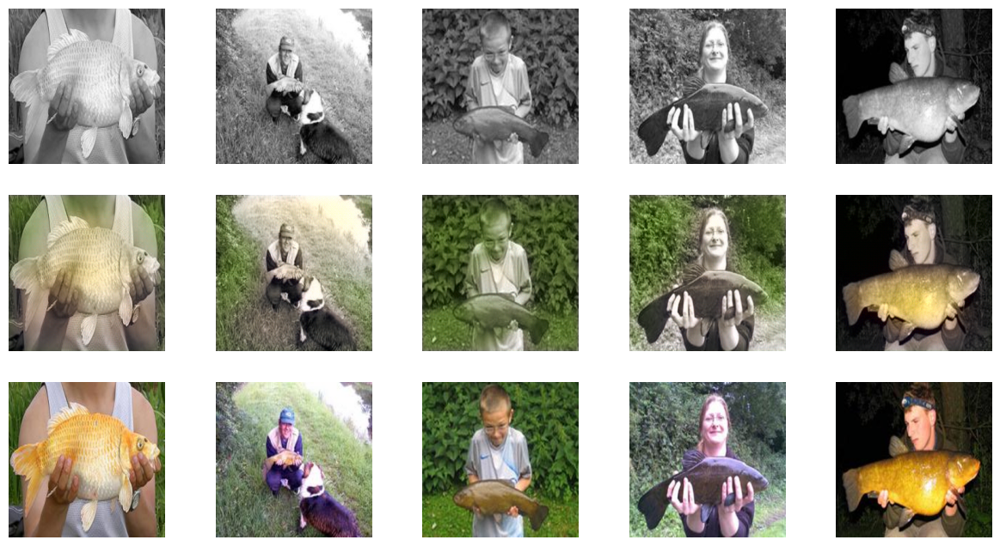

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 10/20
Iteration 10/10
loss_D_fake: 0.32053
loss_D_real: 0.34243
loss_D: 0.33148
loss_G_GAN: 1.73310
loss_G_L1: 8.41578
loss_G: 10.14888


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 14 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


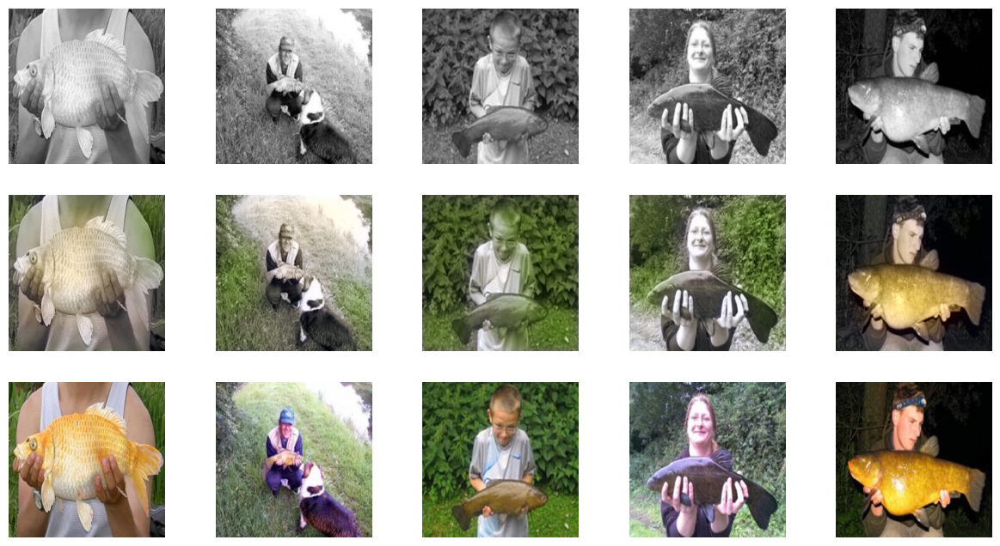

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 11/20
Iteration 10/10
loss_D_fake: 0.49682
loss_D_real: 0.47386
loss_D: 0.48534
loss_G_GAN: 1.72241
loss_G_L1: 8.34588
loss_G: 10.06829


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 8 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


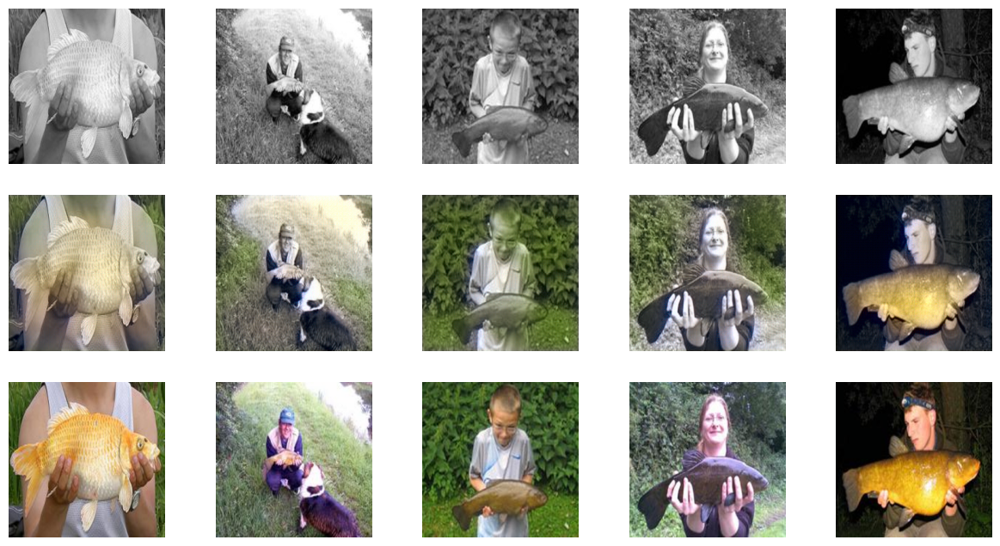

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 12/20
Iteration 10/10
loss_D_fake: 0.57391
loss_D_real: 0.58825
loss_D: 0.58108
loss_G_GAN: 1.16171
loss_G_L1: 8.42989
loss_G: 9.59160


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 1 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


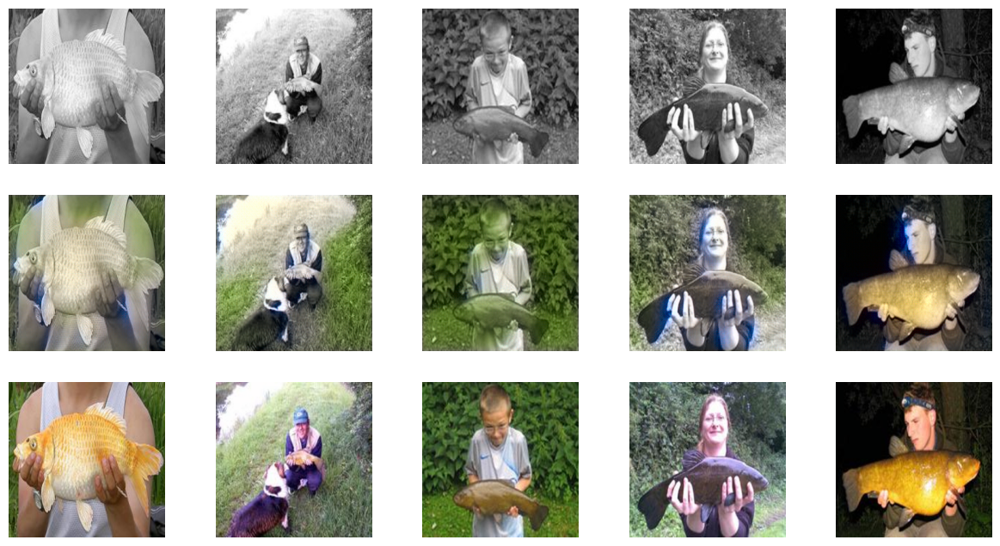

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 13/20
Iteration 10/10
loss_D_fake: 0.57209
loss_D_real: 0.59040
loss_D: 0.58125
loss_G_GAN: 1.13368
loss_G_L1: 8.20913
loss_G: 9.34282


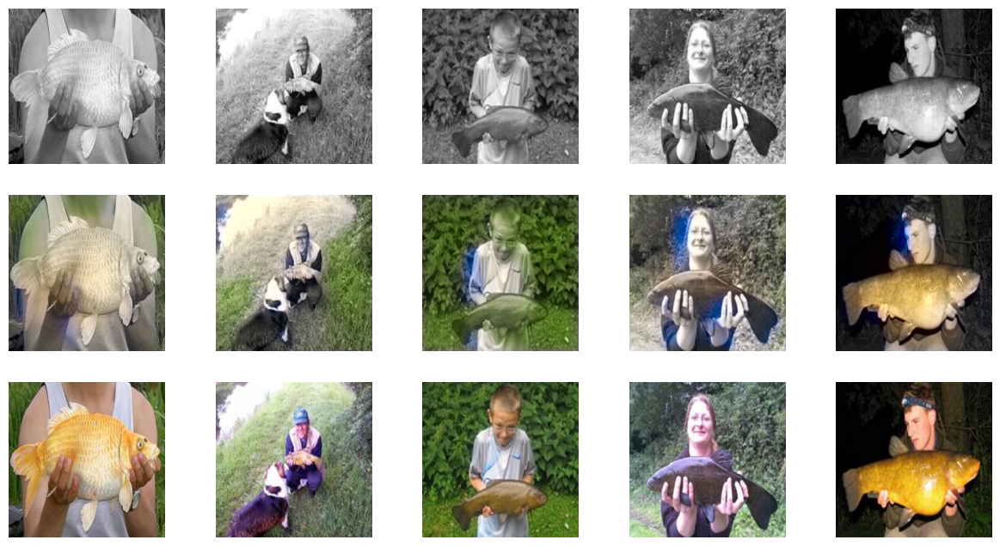

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 14/20
Iteration 10/10
loss_D_fake: 0.57140
loss_D_real: 0.58574
loss_D: 0.57857
loss_G_GAN: 1.12675
loss_G_L1: 7.88936
loss_G: 9.01611


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 5 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


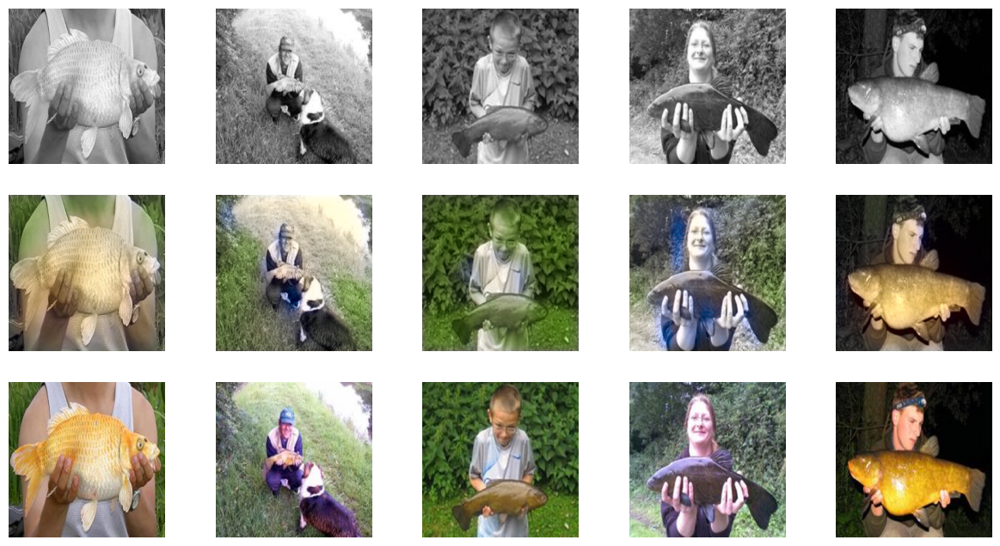

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 15/20
Iteration 10/10
loss_D_fake: 0.61123
loss_D_real: 0.61147
loss_D: 0.61135
loss_G_GAN: 1.03076
loss_G_L1: 7.85568
loss_G: 8.88644


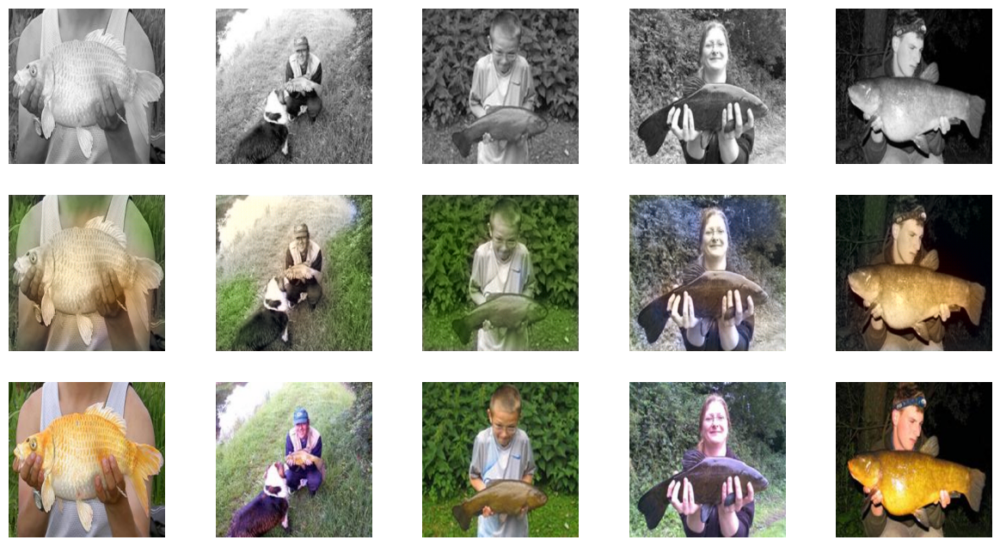

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 16/20
Iteration 10/10
loss_D_fake: 0.60945
loss_D_real: 0.61781
loss_D: 0.61363
loss_G_GAN: 1.08152
loss_G_L1: 7.58265
loss_G: 8.66417


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 161 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


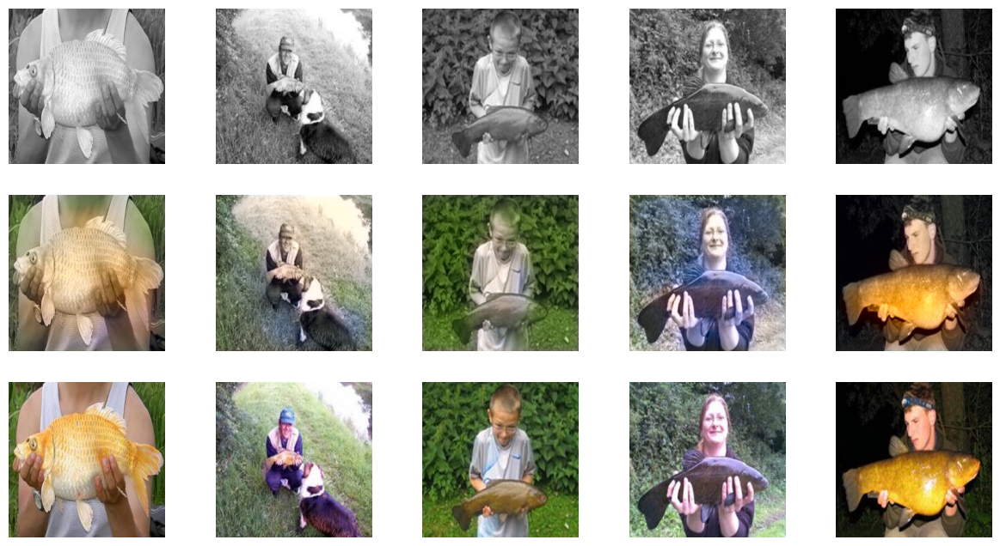

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 17/20
Iteration 10/10
loss_D_fake: 0.62233
loss_D_real: 0.61987
loss_D: 0.62110
loss_G_GAN: 1.11913
loss_G_L1: 7.38845
loss_G: 8.50758


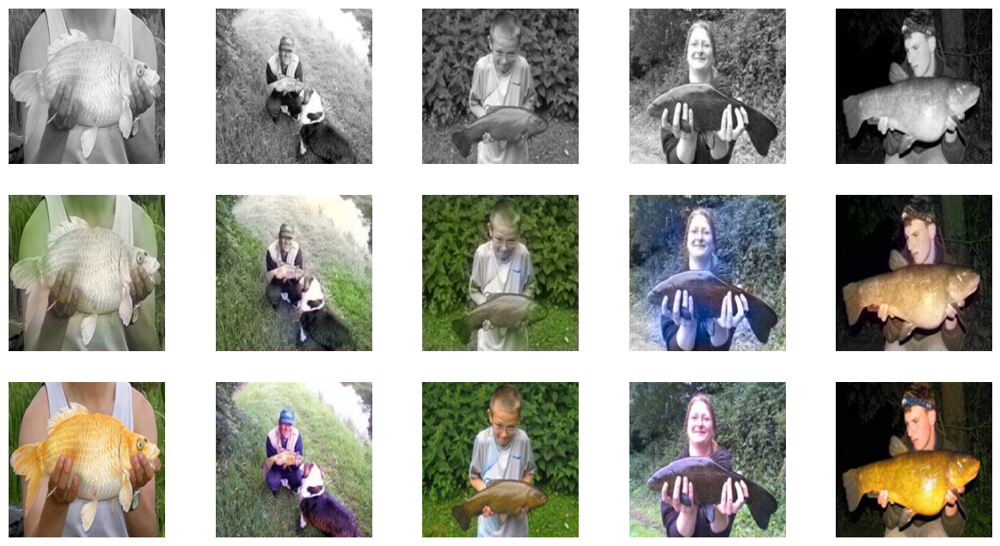

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 18/20
Iteration 10/10
loss_D_fake: 0.59064
loss_D_real: 0.62295
loss_D: 0.60680
loss_G_GAN: 1.05598
loss_G_L1: 7.31468
loss_G: 8.37066


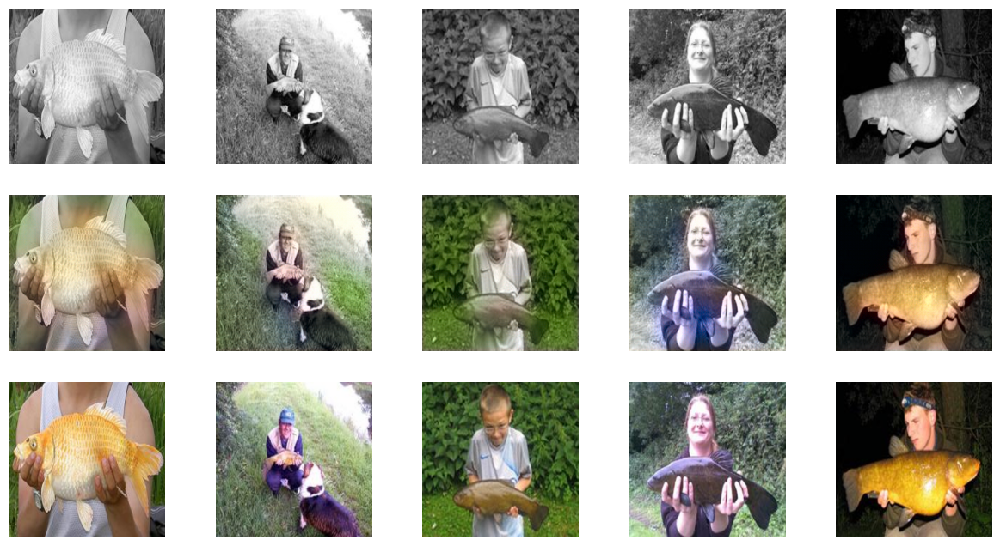

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 19/20
Iteration 10/10
loss_D_fake: 0.64381
loss_D_real: 0.65462
loss_D: 0.64922
loss_G_GAN: 1.02579
loss_G_L1: 7.09998
loss_G: 8.12577


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 62 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


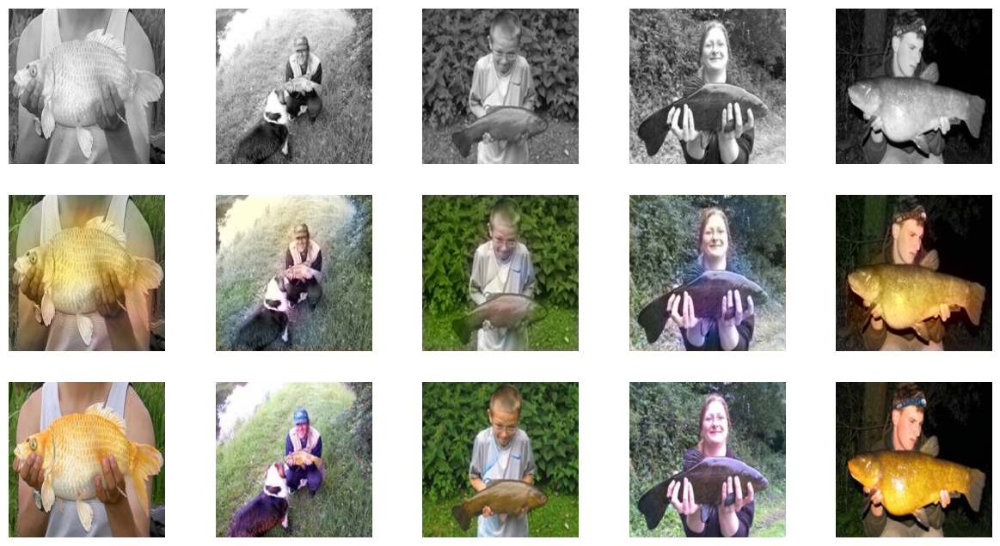

  0%|          | 0/10 [00:00<?, ?it/s]


Epoch 20/20
Iteration 10/10
loss_D_fake: 0.57199
loss_D_real: 0.58105
loss_D: 0.57652
loss_G_GAN: 1.06487
loss_G_L1: 6.93807
loss_G: 8.00294


/var/folders/pr/wxvx7wlx1r5fczqp1p8qmmr80000gp/T/ipykernel_76059/117172840.py:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 10 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


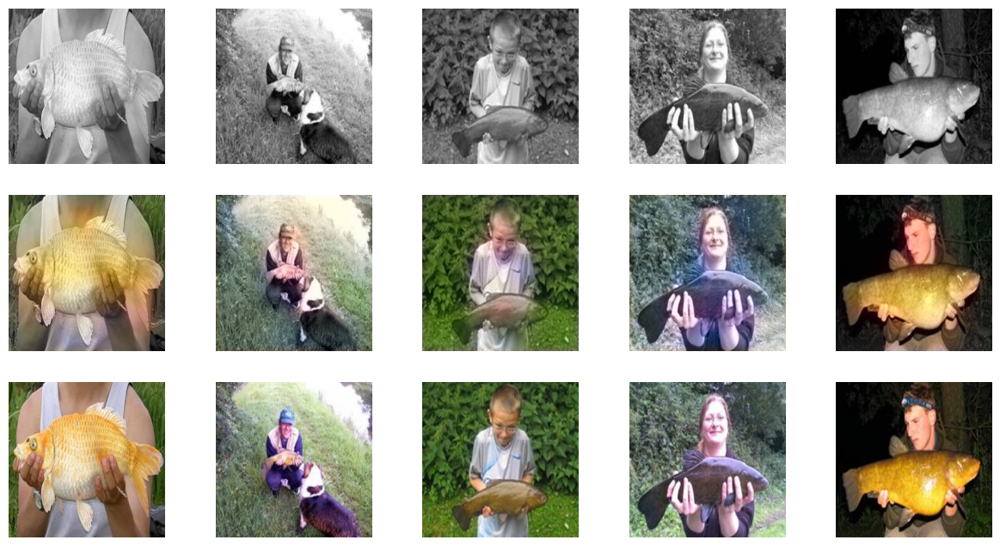

In [21]:
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model = MainModel()
train_model(model, train_dl, 20, display_every=10)